# Pegasus Tutorial

Author: [Yiming Yang](https://github.com/yihming)<br />
Date: 2020-02-01 <br />
Notebook Source: [pegasus_analysis.ipynb](https://raw.githubusercontent.com/klarman-cell-observatory/pegasus/master/notebooks/pegasus_analysis.ipynb)

In [1]:
!date

Fri Oct  8 20:15:53 EDT 2021


#### import libraries and set notebook variables

In [2]:
import pegasus as pg
import os

2021-10-08 20:15:55.751971: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.11.0


In [3]:
# parameters
cohort = 'aging'

In [4]:
# directories
home_dir = '/labshare/raph/datasets/adrd_neuro'
wrk_dir = f'{home_dir}/{cohort}'
results_dir = f'{wrk_dir}/demux'

# in files 
in_file  = f'{results_dir}/{cohort}.h5ad'
markers_json = f'{wrk_dir}/expression/human_brain_cell_markers_LNG.json'

# out files
output_file = f'{results_dir}/{cohort}.pegasus.h5ad'

# constants
leiden_resolution = 0.85

## Count Matrix File

Now load the file using pegasus `read_input` function:

In [5]:
%%time
data = pg.read_input(in_file)
data

2021-10-08 20:15:58,331 - pegasusio.readwrite - INFO - h5ad file '/labshare/raph/datasets/adrd_neuro/aging/demux/aging.h5ad' is loaded.
2021-10-08 20:15:58,333 - pegasusio.readwrite - INFO - Function 'read_input' finished in 1.74s.
CPU times: user 459 ms, sys: 1.28 s, total: 1.74 s
Wall time: 1.74 s


MultimodalData object with 1 UnimodalData: 'unknown-rna'
    It currently binds to UnimodalData object unknown-rna

UnimodalData object with n_obs x n_vars = 168090 x 36601
    Genome: unknown; Modality: rna
    It contains 1 matrix: 'X'
    It currently binds to matrix 'X' as X

    obs: 'pool_name', 'Sample_id', 'Tissue_source', 'Brain_region', 'Clinical_diagnosis', 'Age', 'Sex', 'donor_id', 'lane_num'
    var: 
    obsm: 
    varm: 
    uns: 'genome', 'modality'

The count matrix is managed as a UnimodalData object defined in [PegasusIO](https://pegasusio.readthedocs.io) module, and users can manipulate the data from top level via MultimodalData structure, which can contain multiple UnimodalData objects as members.

For this example, as show above, `data` is a MultimodalData object, with only one UnimodalData member of key `"GRCh38-rna"`, which is its default UnimodalData. Any operation on `data` will be applied to this default UnimodalData object.

UnimodalData has the following structure:

<img src="https://raw.githubusercontent.com/klarman-cell-observatory/pegasus/master/notebooks/unidata.png" width="50%" />

It has 6 major parts:
* Raw count matrix: `data.X`, a [Scipy sparse matrix](https://docs.scipy.org/doc/scipy/reference/generated/scipy.sparse.csr_matrix.html) (sometimes can be a dense matrix), with rows the cell barcodes, columns the genes/features:

In [6]:
data.X

<168090x36601 sparse matrix of type '<class 'numpy.float32'>'
	with 583918061 stored elements in Compressed Sparse Row format>

In [7]:
data

MultimodalData object with 1 UnimodalData: 'unknown-rna'
    It currently binds to UnimodalData object unknown-rna

UnimodalData object with n_obs x n_vars = 168090 x 36601
    Genome: unknown; Modality: rna
    It contains 1 matrix: 'X'
    It currently binds to matrix 'X' as X

    obs: 'pool_name', 'Sample_id', 'Tissue_source', 'Brain_region', 'Clinical_diagnosis', 'Age', 'Sex', 'donor_id', 'lane_num'
    var: 
    obsm: 
    varm: 
    uns: 'genome', 'modality'

This dataset contains $37609$ barcodes and $36,601$ genes.

* Cell barcode attributes: `data.obs`, a [Pandas data frame](https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.DataFrame.html) with barcode as the index. For now, there is only one attribute `"Channel"` referring to the donor from which the cell comes from:

In [8]:
display(data.obs.head())

,pool_name,Sample_id,Tissue_source,Brain_region,Clinical_diagnosis,Age,Sex,donor_id,lane_num
barcodekey,,,,,,,,,
AAACCCACAGTTGGTT-1,P001,Aging080,NIMH Human Brain Collection Core,Middle temporal gyrus,Healthy,21.5,Female,NHBCC-1187,1
AAACCCATCTCGCTTG-1,P001,Aging073,NIMH Human Brain Collection Core,Middle temporal gyrus,Healthy,64.3,Female,NHBCC-1119,1
AAACGAACACGGTAGA-1,P001,Aging095,NIMH Human Brain Collection Core,Middle temporal gyrus,Healthy,27.2,Male,NHBCC-1604,1
AAACGCTAGAACTCCT-1,P001,Aging073,NIMH Human Brain Collection Core,Middle temporal gyrus,Healthy,64.3,Female,NHBCC-1119,1
AAACGCTAGTCAGCCC-1,P001,Aging073,NIMH Human Brain Collection Core,Middle temporal gyrus,Healthy,64.3,Female,NHBCC-1119,1


In [9]:
data.obs['Sample_id'].value_counts()

Aging097    11636
Aging096     9785
Aging082     7878
Aging108     7626
Aging110     7494
Aging081     7445
Aging114     6725
Aging074     6106
Aging109     5197
Aging092     4759
Aging104     4750
Aging112     4596
Aging090     4193
Aging106     3918
Aging070     3776
Aging098     3444
Aging107     3221
Aging095     3215
Aging073     3032
Aging077     3016
Aging086     2917
Aging105     2798
Aging116     2792
Aging103     2776
Aging099     2690
Aging083     2649
Aging071     2607
Aging085     2419
Aging080     2387
Aging084     2201
Aging094     2199
Aging075     2179
Aging101     2089
Aging069     2007
Aging088     1875
Aging117     1861
Aging091     1785
Aging102     1772
Aging089     1756
Aging100     1697
Aging072     1655
Aging113     1652
Aging118     1528
Aging111     1393
Aging076     1344
Aging079     1275
Aging115     1258
Aging078      717
Name: Sample_id, dtype: int64

In [10]:
data.obs['Channel'] = data.obs['Sample_id']

In [11]:
data.obs['Channel'].value_counts()

Aging097    11636
Aging096     9785
Aging082     7878
Aging108     7626
Aging110     7494
Aging081     7445
Aging114     6725
Aging074     6106
Aging109     5197
Aging092     4759
Aging104     4750
Aging112     4596
Aging090     4193
Aging106     3918
Aging070     3776
Aging098     3444
Aging107     3221
Aging095     3215
Aging073     3032
Aging077     3016
Aging086     2917
Aging105     2798
Aging116     2792
Aging103     2776
Aging099     2690
Aging083     2649
Aging071     2607
Aging085     2419
Aging080     2387
Aging084     2201
Aging094     2199
Aging075     2179
Aging101     2089
Aging069     2007
Aging088     1875
Aging117     1861
Aging091     1785
Aging102     1772
Aging089     1756
Aging100     1697
Aging072     1655
Aging113     1652
Aging118     1528
Aging111     1393
Aging076     1344
Aging079     1275
Aging115     1258
Aging078      717
Name: Channel, dtype: int64

* Gene attributes: `data.var`, also a Pandas data frame, with gene name as the index. For now, it only has one attribute `"featureid"` referring to the unique gene ID in the experiment:

In [12]:
display(data.var.head())

""
featurekey
MIR1302-2HG
FAM138A
OR4F5
AL627309.1
AL627309.3


* Unstructured information: `data.uns`, a Python [hashed dictionary](https://docs.python.org/3/library/collections.html#collections.OrderedDict). It usually stores information not restricted to barcodes or features, but about the whole dataset, such as its genome reference and modality type:

In [13]:
data.uns['genome']

'unknown'

In [14]:
data.uns['modality']

'rna'

* Finally, embedding attributes on cell barcodes: `data.obsm`; as well as on genes, `data.varm`. We'll see it in later sections.

## Preprocessing

### Filtration

The first step in preprocessing is to perform the quality control analysis, and remove cells and genes of low quality.

We can generate QC metrics using the following method with default settings:

In [15]:
pg.qc_metrics(data, min_genes=200, min_umis=3, mito_prefix='MT-', percent_mito=10)

The metrics considered are:
* **Number of genes**: Keep cells with $500 \leq \text{# Genes} < 6000$. <span style="color:red">**(Notice that starting from v1.4.0, Pegasus doesn't filter cells by number of genes threshold by default.)**</span>
* **Number of UMIs**: Don't filter cells due to UMI bounds *(Default)*;
* **Percent of Mitochondrial genes**: Look for mitochondrial genes with name prefix `MT-` <span style="color:red">**(Notice that starting from v1.4.0, you'll need to manually specify this prefix.)**</span>, and keep cells with percent $< 10\%$.

For details on customizing your own thresholds, see [documentation](https://pegasus.readthedocs.io/en/stable/api/pegasus.qc_metrics.html).

Numeric summaries on filtration on cell barcodes and genes can be achieved by `get_filter_stats` method:

In [16]:
df_qc = pg.get_filter_stats(data)
display(df_qc)

,kept,median_n_genes,median_n_umis,median_percent_mito,filt,total,median_n_genes_before,median_n_umis_before,median_percent_mito_before
Channel,,,,,,,,,
Aging078,716,3332.5,8178.0,0.290202,1,717,3332.0,8172.0,0.291715
Aging115,1257,3797.0,9310.0,0.209205,1,1258,3795.5,9302.5,0.209312
Aging079,1275,2443.0,5597.0,0.096463,0,1275,2443.0,5597.0,0.096463
Aging076,1343,5854.0,21739.0,0.166980,1,1344,5851.0,21737.5,0.167102
Aging111,1392,5317.0,18637.5,0.127242,1,1393,5316.0,18590.0,0.127276
Aging118,1528,2709.0,6350.0,0.071015,0,1528,2709.0,6350.0,0.071015
Aging113,1652,4489.5,14869.5,0.083206,0,1652,4489.5,14869.5,0.083206
Aging072,1655,2196.0,4303.0,0.032982,0,1655,2196.0,4303.0,0.032982
Aging100,1695,1934.0,3459.0,0.137137,2,1697,1929.0,3433.0,0.137174


The results is a Pandas data frame on samples.

You can also check the QC stats via plots. Below is on number of genes:

In [17]:
display(data.obs.loc[data.obs['Channel'].isna()])

,pool_name,Sample_id,Tissue_source,Brain_region,Clinical_diagnosis,Age,Sex,donor_id,lane_num,Channel,n_genes,n_counts,percent_mito,passed_qc
barcodekey,,,,,,,,,,,,,,


In [18]:
data.obs.info()

<class 'pandas.core.frame.DataFrame'>
Index: 168090 entries, AAACCCACAGTTGGTT-1 to TTTGTTGTCTCTCTTC-1
Data columns (total 14 columns):
 #   Column              Non-Null Count   Dtype   
---  ------              --------------   -----   
 0   pool_name           168090 non-null  category
 1   Sample_id           168090 non-null  category
 2   Tissue_source       168090 non-null  category
 3   Brain_region        168090 non-null  category
 4   Clinical_diagnosis  168090 non-null  category
 5   Age                 168090 non-null  float64 
 6   Sex                 168090 non-null  category
 7   donor_id            168090 non-null  category
 8   lane_num            168090 non-null  category
 9   Channel             168090 non-null  category
 10  n_genes             168090 non-null  int32   
 11  n_counts            168090 non-null  float32 
 12  percent_mito        168090 non-null  float32 
 13  passed_qc           168090 non-null  bool    
dtypes: bool(1), category(9), float32(2), float64

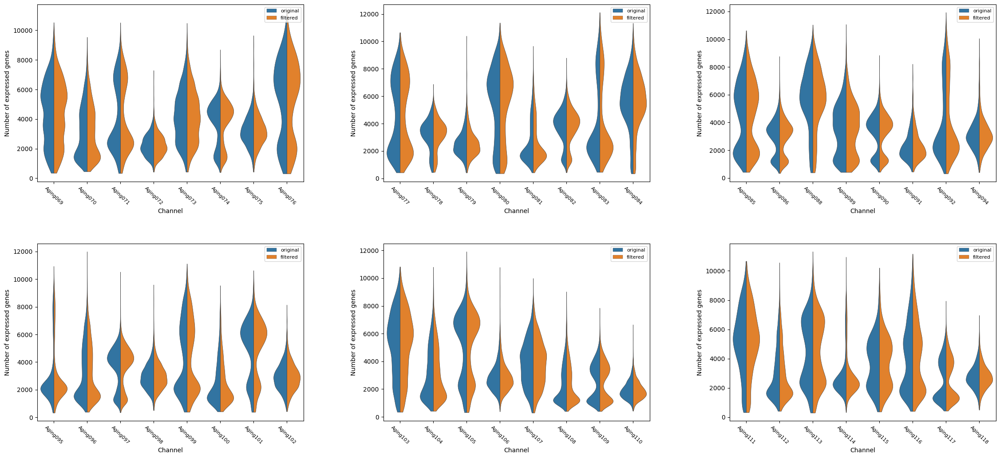

In [19]:
pg.qcviolin(data, plot_type='gene', dpi=100)

Then on number of UMIs:

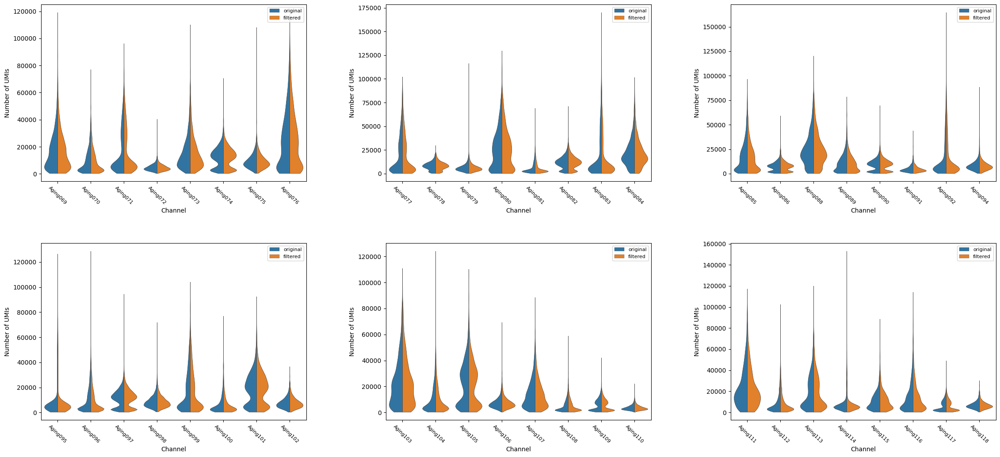

In [20]:
pg.qcviolin(data, plot_type='count', dpi=100)

On number of percentage of mitochondrial genes:

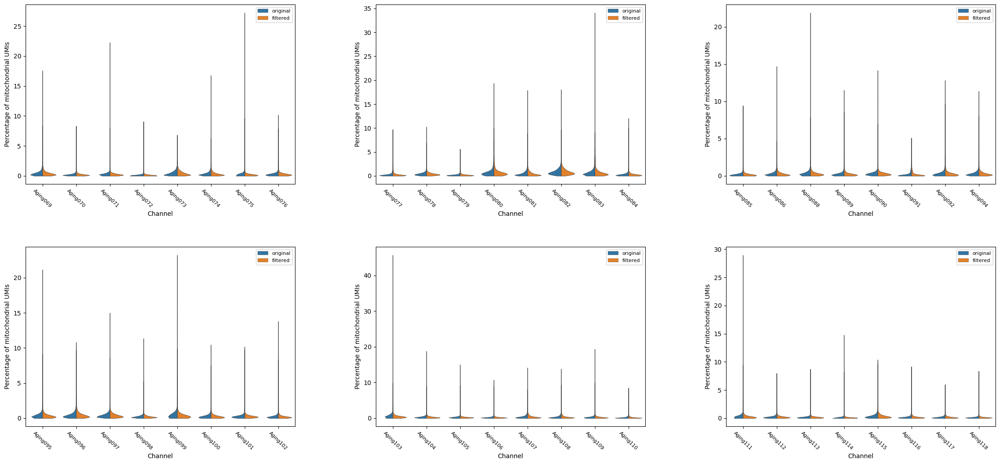

In [21]:
pg.qcviolin(data, plot_type='mito', dpi=100)

Now filter cells based on QC metrics set in `qc_metrics`:

In [22]:
pg.filter_data(data)

2021-10-08 20:16:06,658 - pegasusio.qc_utils - INFO - After filtration, 167945 out of 168090 cell barcodes are kept in UnimodalData object unknown-rna.
2021-10-08 20:16:06,659 - pegasus.tools.preprocessing - INFO - Function 'filter_data' finished in 1.06s.


You can see that $167945$ cells ($99.9\%$) are kept.

Moreover, for genes, only those with no cell expression are removed. After that, we identify **robust** genes for downstream analysis:

In [23]:
pg.identify_robust_genes(data)

2021-10-08 20:16:10,655 - pegasus.tools.preprocessing - INFO - After filtration, 35441/36601 genes are kept. Among 35441 genes, 29580 genes are robust.
2021-10-08 20:16:10,656 - pegasus.tools.preprocessing - INFO - Function 'identify_robust_genes' finished in 3.99s.


The metric is the following:
* Gene is expressed in at least $0.05\%$ of cells, i.e. among every 6000 cells, there are at least 3 cells expressing this gene.

Please see [its documentation](https://pegasus.readthedocs.io/en/stable/api/pegasus.identify_robust_genes.html) for details.

We can now view the cells of each sample after filtration:

In [24]:
data.obs['Channel'].value_counts()

Aging097    11634
Aging096     9784
Aging082     7870
Aging108     7624
Aging110     7494
Aging081     7441
Aging114     6723
Aging074     6103
Aging109     5195
Aging092     4754
Aging104     4747
Aging112     4596
Aging090     4190
Aging106     3917
Aging070     3776
Aging098     3443
Aging107     3217
Aging095     3206
Aging073     3032
Aging077     3016
Aging086     2916
Aging105     2794
Aging116     2792
Aging103     2751
Aging099     2658
Aging083     2646
Aging071     2606
Aging085     2419
Aging080     2376
Aging084     2200
Aging094     2198
Aging075     2175
Aging101     2088
Aging069     2005
Aging088     1874
Aging117     1861
Aging091     1785
Aging102     1771
Aging089     1755
Aging100     1695
Aging072     1655
Aging113     1652
Aging118     1528
Aging111     1392
Aging076     1343
Aging079     1275
Aging115     1257
Aging078      716
Name: Channel, dtype: int64

In [25]:
data.obs['pool_name'].value_counts()

P004    41418
P003    40485
P005    30638
P001    19294
P006    18953
P002    17157
Name: pool_name, dtype: int64

### Normalization and Logarithmic Transformation

After filtration, we need to first normalize the distribution of counts w.r.t. each cell to have the same sum (default is $10^5$, see [documentation](https://pegasus.readthedocs.io/en/stable/api/pegasus.log_norm.html)), and then transform into logarithmic space by $log(x + 1)$ to avoid number explosion:

In [26]:
pg.log_norm(data)

2021-10-08 20:16:18,838 - pegasus.tools.preprocessing - INFO - Function 'log_norm' finished in 8.16s.


For the downstream analysis, we may need to make a copy of the count matrix, in case of coming back to this step and redo the analysis:

In [27]:
data_trial = data.copy()

### Highly Variable Gene Selection

**Highly Variable Genes (HVG)** are more likely to convey information discriminating different cell types and states.
Thus, rather than considering all genes, people usually focus on selected HVGs for downstream analyses.

You need to set `consider_batch` flag to consider or not consider batch effect. At this step, set it to `False`:

In [28]:
pg.highly_variable_features(data_trial, consider_batch=False)

2021-10-08 20:16:21,142 - pegasus.tools.hvf_selection - INFO - Function 'estimate_feature_statistics' finished in 1.13s.
2021-10-08 20:16:21,197 - pegasus.tools.hvf_selection - INFO - 2000 highly variable features have been selected.
2021-10-08 20:16:21,198 - pegasus.tools.hvf_selection - INFO - Function 'highly_variable_features' finished in 1.19s.


By default, we select 2000 HVGs using the pegasus selection method. Alternative, you can also choose the traditional method that both *Seurat* and *SCANPY* use, by setting `flavor='Seurat'`. See [documentation](https://pegasus.readthedocs.io/en/stable/api/pegasus.highly_variable_features.html) for details.

We can view HVGs by ranking them from top:

In [29]:
data_trial.var.loc[data_trial.var['highly_variable_features']].sort_values(by='hvf_rank')

,n_cells,percent_cells,robust,highly_variable_features,mean,var,hvf_loess,hvf_rank
featurekey,,,,,,,,
ST18,77574,46.190122,True,True,2.227969,6.976405,3.147909,0
KCNIP4,137300,81.752955,True,True,4.574248,6.615814,3.033597,2
PLP1,101737,60.577570,True,True,2.692636,6.710679,3.335686,4
RNF220,82577,49.169073,True,True,2.164213,6.133236,3.115610,9
RBFOX1,137541,81.896454,True,True,4.601305,6.022954,3.018887,9
...,...,...,...,...,...,...,...,...
LCNL1,6720,4.001310,True,True,0.105767,0.299534,0.248494,5412
RASSF3,10027,5.970407,True,True,0.150180,0.410031,0.344280,5413
EFHC2,13430,7.996666,True,True,0.200493,0.541896,0.459616,5415


We can also view HVGs in a scatterplot:

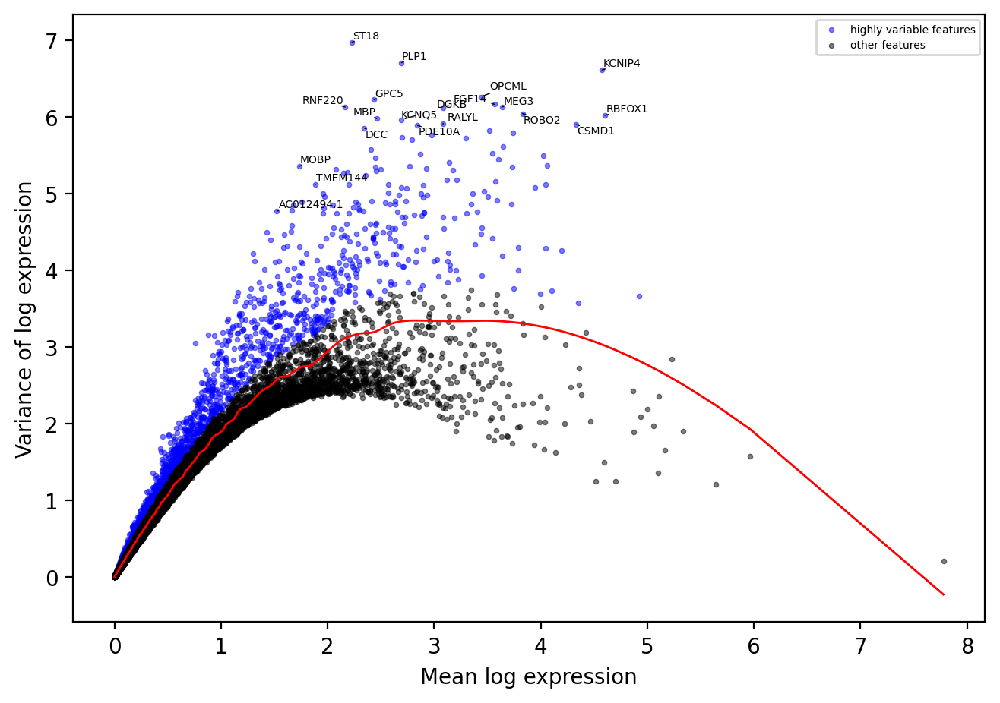

In [30]:
pg.hvfplot(data_trial, dpi=200)

In this plot, each point stands for one gene. Blue points are selected to be HVGs, which account for the majority of variation of the dataset.

### Principal Component Analysis

To reduce the dimension of data, Principal Component Analysis (PCA) is widely used. Briefly speaking, PCA transforms the data from original dimensions into a new set of Principal Components (PC) of a much smaller size. In the transformed data, dimension is reduced, while PCs still cover a majority of the variation of data. Moreover, the new dimensions (i.e. PCs) are independent with each other.

`pegasus` uses the following method to perform PCA:

In [31]:
pg.pca(data_trial)

2021-10-08 20:16:36,405 - pegasus.tools.preprocessing - INFO - Function 'pca' finished in 8.42s.


By default, `pca` uses:
* Before PCA, scale the data to standard Normal distribution $N(0, 1)$, and truncate them with max value $10$;
* Number of PCs to compute: 50;
* Apply PCA only to highly variable features.

See [its documentation](https://pegasus.readthedocs.io/en/stable/api/pegasus.pca.html) for customization.

To explain the meaning of PCs, let's look at the first PC (denoted as $PC_1$), which covers the most of variation:

In [32]:
coord_pc1 = data_trial.uns['PCs'][:, 0]
coord_pc1

array([ 0.02054538,  0.00193981,  0.00422663, ..., -0.01733679,
       -0.0231966 , -0.02323688], dtype=float32)

This is an array of 2000 elements, each of which is a coefficient corresponding to one HVG.

With the HVGs as the following:

In [33]:
data_trial.var.loc[data_trial.var['highly_variable_features']].index.values

array(['VWA1', 'PRDM16-DT', 'PRDM16', ..., 'TTTY14', 'MT-ATP6', 'MT-CO3'],
      dtype=object)

$PC_1$ is computed by

\begin{equation*}
PC_1 = \text{coord_pc1}[0] \cdot \text{HES4} + \text{coord_pc1}[1] \cdot \text{ISG15} + \text{coord_pc1}[2] \cdot \text{TNFRSF18} + \cdots + \text{coord_pc1}[1997] \cdot \text{RPS4Y2} + \text{coord_pc1}[1998] \cdot \text{MT-CO1} + \text{coord_pc1}[1999] \cdot \text{MT-CO3}
\end{equation*}

Therefore, all the 50 PCs are the linear combinations of the 2000 HVGs.

The calculated PCA count matrix is stored in the `obsm` field, which is the first embedding object we have 

In [34]:
data_trial.obsm['X_pca'].shape

(167945, 50)

For each of the cells, its count is now w.r.t. 50 PCs, instead of 2000 HVGs.

## Nearest Neighbors

All the downstream analysis, including clustering and visualization, needs to construct a k-Nearest-Neighbor (kNN) graph on cells. We can build such a graph using `neighbors` method:

In [35]:
pg.neighbors(data_trial)

2021-10-08 20:16:59,701 - pegasus.tools.nearest_neighbors - INFO - Function 'get_neighbors' finished in 23.27s.
2021-10-08 20:17:04,882 - pegasus.tools.nearest_neighbors - INFO - Function 'calculate_affinity_matrix' finished in 5.18s.


It uses the default setting:
* For each cell, calculate its 100 nearest neighbors;
* Use PCA matrix for calculation;
* Use L2 distance as the metric;
* Use [hnswlib](https://github.com/nmslib/hnswlib) search algorithm to calculate the approximated nearest neighbors in a really short time.

See [its documentation](https://pegasus.readthedocs.io/en/stable/api/pegasus.neighbors.html) for customization.

Below is the result:

In [36]:
print(f"Get {data_trial.uns['pca_knn_indices'].shape[1]} nearest neighbors (excluding itself) for each cell.")
data_trial.uns['pca_knn_indices']

Get 99 nearest neighbors (excluding itself) for each cell.


array([[   960,  17827,  13826, ...,  25419,  14718,   8203],
       [ 18166,   5376,   2793, ...,  11546,    216,   5340],
       [ 19011,    680,  12795, ...,   2156,  19319,  15123],
       ...,
       [160562, 153917, 166470, ..., 155711, 154581, 152235],
       [157213, 158857, 153448, ..., 161202,  32711, 165762],
       [162702, 163259, 156145, ..., 152676, 150607, 161642]])

In [37]:
data_trial.uns['pca_knn_distances']

array([[ 4.4231586,  4.5468874,  4.7031116, ...,  7.0245414,  7.033678 ,
         7.04727  ],
       [ 4.497844 ,  4.557515 ,  4.7155113, ...,  6.0997205,  6.102543 ,
         6.1146545],
       [ 5.889608 ,  6.0204844,  6.2888613, ...,  7.2560935,  7.2570333,
         7.2616687],
       ...,
       [ 6.291992 ,  6.420031 ,  6.7242084, ...,  8.1569395,  8.159344 ,
         8.169074 ],
       [ 7.191315 ,  7.3226395,  7.3776183, ..., 11.659287 , 11.68705  ,
        11.731778 ],
       [ 5.5626416,  5.755796 ,  5.7771273, ...,  6.9271493,  6.9293847,
         6.939952 ]], dtype=float32)

Each row corresponds to one cell, listing its neighbors (not including itself) from nearest to farthest. `data_trial.uns['pca_knn_indices']` stores their indices, and `data_trial.uns['pca_knn_distances']` stores distances.

## Clustering and Visualization

Now we are ready to cluster the data for cell type detection. `pegasus` provides 4 clustering algorithms to use:
* `louvain`: Louvain algorithm, using [louvain](https://github.com/vtraag/louvain-igraph) package.
* `leiden`: Leiden algorithm, using [leidenalg](https://github.com/vtraag/leidenalg) package.
* `spectral_louvain`: Spectral Louvain algorithm, which requires Diffusion Map.
* `spectral_leiden`: Spectral Leiden algorithm, which requires Diffusion Map.

See [this documentation](https://pegasus.readthedocs.io/en/stable/api/index.html#cluster-algorithms) for details.

In this tutorial, we use the Louvain algorithm:

In [38]:
pg.leiden(data_trial, resolution=leiden_resolution)

2021-10-08 20:17:11,289 - pegasus.tools.graph_operations - INFO - Function 'construct_graph' finished in 6.39s.
2021-10-08 20:17:37,137 - pegasus.tools.clustering - INFO - Leiden clustering is done. Get 29 clusters.
2021-10-08 20:17:37,985 - pegasus.tools.clustering - INFO - Function 'leiden' finished in 33.09s.


As a result, Louvain algorithm finds 32 clusters:

In [39]:
data_trial.obs['leiden_labels'].value_counts()

1     23362
2     20111
3      8092
4      7879
5      7515
6      7341
7      6853
8      6723
9      6701
10     6672
11     6390
12     6389
13     6131
14     5774
15     5728
16     5345
17     4558
18     2990
19     2816
20     2793
21     2582
22     2464
23     2159
24     2151
25     1904
26     1792
27     1726
28     1704
29     1300
Name: leiden_labels, dtype: int64

We can check each cluster's composition regarding donors via a composition plot:

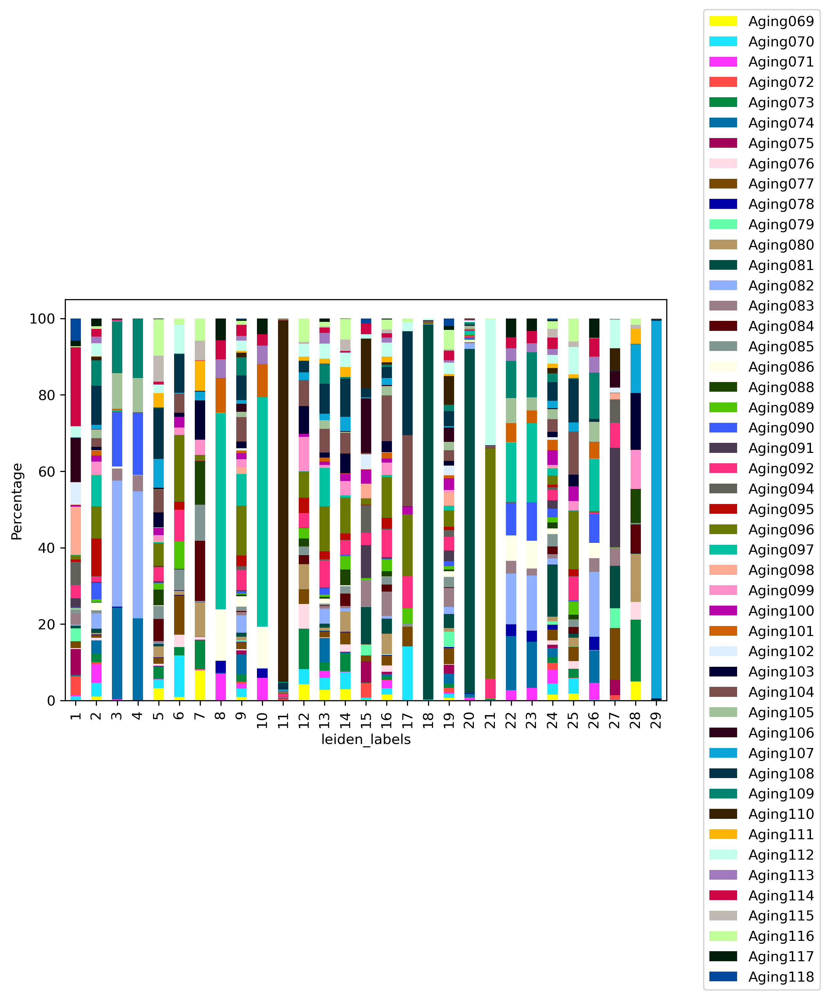

In [40]:
pg.compo_plot(data_trial, 'leiden_labels', 'Channel')

## Batch Correction

Batch effect occurs when data samples are generated in different conditions, such as date, weather, lab setting, equipment, etc. Unless informed that all the samples were generated under the similar condition, people may suspect presumable batch effects if they see a visualization graph with samples kind-of isolated from each other.

For this dataset, we need the batch correction step to reduce such a batch effect, which is observed in the plot above.

In this tutorial, we use [Harmony](https://www.nature.com/articles/s41592-019-0619-0) algorithm for batch correction. It requires redo HVG selection, calculate new PCA coordinates, and apply the correction:

In [41]:
pg.highly_variable_features(data, consider_batch=True)
pg.pca(data)
pca_key = pg.run_harmony(data, batch='pool_name', use_gpu=True)

2021-10-08 20:17:45,007 - pegasus.tools.hvf_selection - INFO - Function 'estimate_feature_statistics' finished in 4.72s.
2021-10-08 20:17:45,058 - pegasus.tools.hvf_selection - INFO - 2000 highly variable features have been selected.
2021-10-08 20:17:45,059 - pegasus.tools.hvf_selection - INFO - Function 'highly_variable_features' finished in 4.77s.
2021-10-08 20:17:53,285 - pegasus.tools.preprocessing - INFO - Function 'pca' finished in 8.23s.
2021-10-08 20:17:53,895 - pegasus.tools.batch_correction - INFO - Start integration using Harmony.
Use GPU mode.
	Initialization is completed.
	Completed 1 / 10 iteration(s).
	Completed 2 / 10 iteration(s).
	Completed 3 / 10 iteration(s).
	Completed 4 / 10 iteration(s).
Reach convergence after 4 iteration(s).
2021-10-08 20:18:34,584 - pegasus.tools.batch_correction - INFO - Function 'run_harmony' finished in 41.30s.


The corrected PCA coordinates are stored in `data.obsm`:

In [42]:
data.obsm['X_pca_harmony'].shape

(167945, 50)

`pca_key` is the representation key returned by `run_harmony` function, which is equivalent to string `"pca_harmony"`. In the following sections, you can use either `pca_key` or `"pca_harmony"` to specify `rep` parameter in Pegasus functions whenever applicable.

## Repeat Previous Steps on the Corrected Data

As the count matrix is changed by batch correction, we need to recalculate nearest neighbors and perform clustering. Don't forget to use the corrected PCA coordinates as the representation:

In [43]:
pg.neighbors(data, rep=pca_key)
pg.leiden(data, rep=pca_key, resolution=leiden_resolution)

2021-10-08 20:19:02,775 - pegasus.tools.nearest_neighbors - INFO - Function 'get_neighbors' finished in 28.18s.
2021-10-08 20:19:07,917 - pegasus.tools.nearest_neighbors - INFO - Function 'calculate_affinity_matrix' finished in 5.14s.
2021-10-08 20:19:14,483 - pegasus.tools.graph_operations - INFO - Function 'construct_graph' finished in 6.56s.
2021-10-08 20:20:01,452 - pegasus.tools.clustering - INFO - Leiden clustering is done. Get 25 clusters.
2021-10-08 20:20:02,367 - pegasus.tools.clustering - INFO - Function 'leiden' finished in 54.45s.


Let's check the composition plot now:

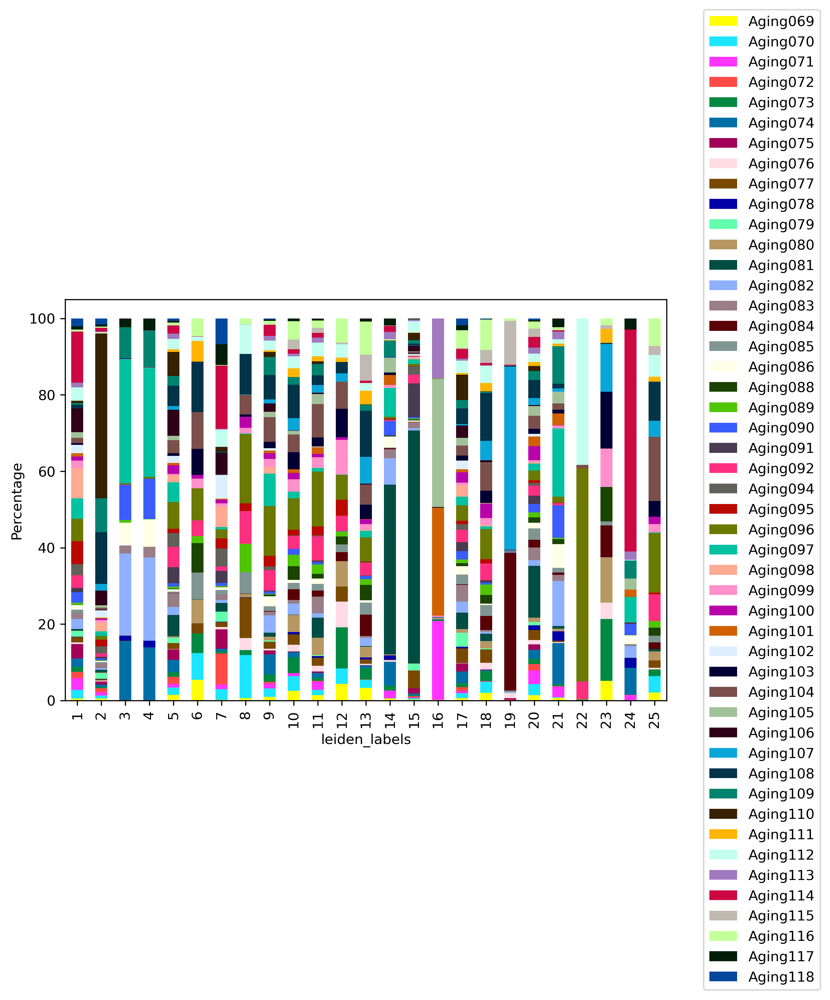

In [44]:
pg.compo_plot(data, 'leiden_labels', 'Channel')

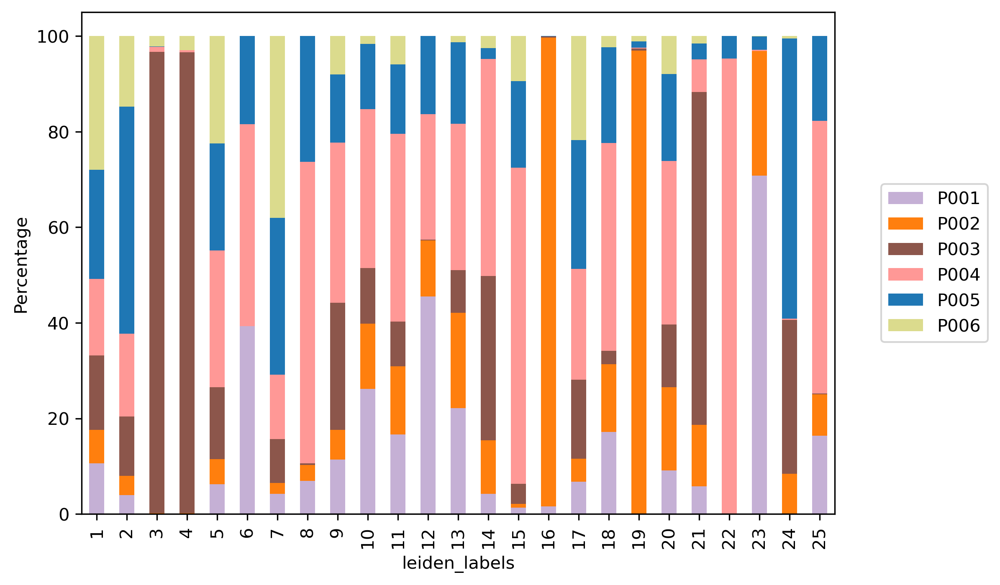

In [45]:
pg.compo_plot(data, 'leiden_labels', 'pool_name')

## Visualization

### UMAP Plot

Besides tSNE, `pegasus` also provides UMAP plotting methods:

* `umap`: UMAP plot, using [umap-learn](https://github.com/lmcinnes/umap) package. [See details](https://pegasus.readthedocs.io/en/stable/api/pegasus.umap.html)
* `net_umap`: Approximated UMAP plot with DNN model based speed up. [See details](https://pegasus.readthedocs.io/en/stable/api/pegasus.net_umap.html)

Below is the UMAP plot of the data using `umap` method:

In [46]:
pg.umap(data, rep=pca_key)

2021-10-08 20:20:05,284 - pegasus.tools.nearest_neighbors - INFO - Found cached kNN results, no calculation is required.
2021-10-08 20:20:05,286 - pegasus.tools.nearest_neighbors - INFO - Function 'get_neighbors' finished in 0.00s.
2021-10-08 20:20:05,334 - pegasus.tools.visualization - INFO - UMAP(dens_frac=0.0, dens_lambda=0.0, min_dist=0.5, random_state=0, verbose=True)
2021-10-08 20:20:05,335 - pegasus.tools.visualization - INFO - Construct fuzzy simplicial set
2021-10-08 20:20:07,972 - pegasus.tools.visualization - INFO - Construct embedding
	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
2021-10-08 20:23:15,370 - pegasus.tools.visualization - INFO - Function 'umap' finished in 190.09s.


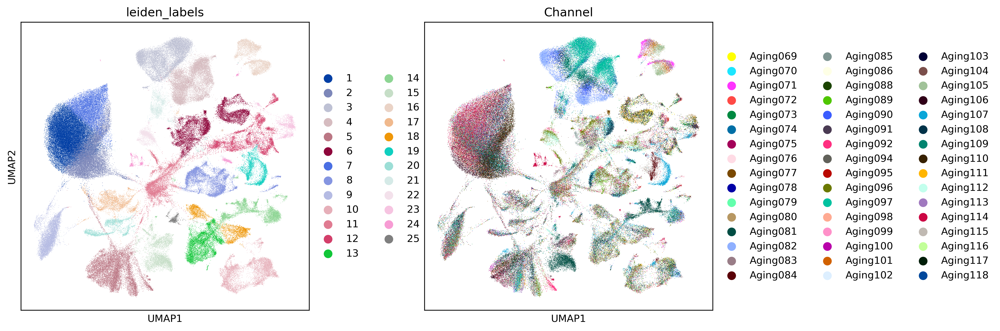

In [47]:
pg.scatter(data, attrs=['leiden_labels', 'Channel'], basis='umap')

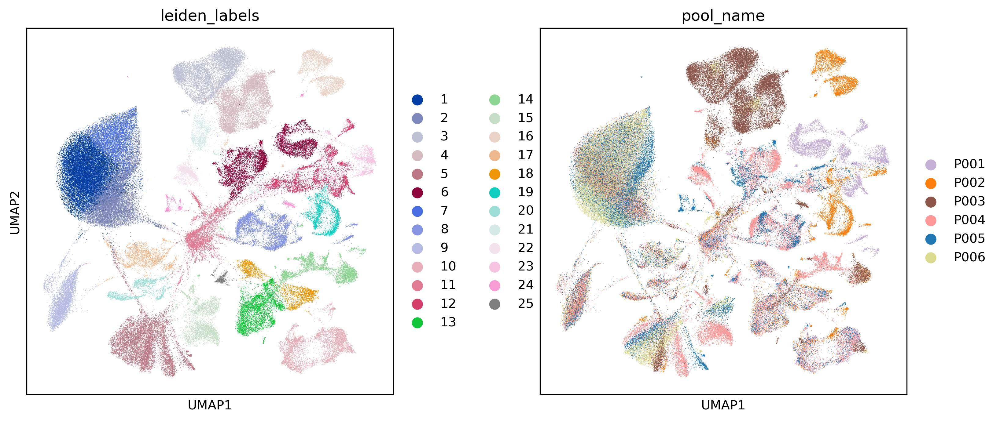

In [48]:
pg.scatter(data, attrs=['leiden_labels', 'pool_name'], basis='umap')

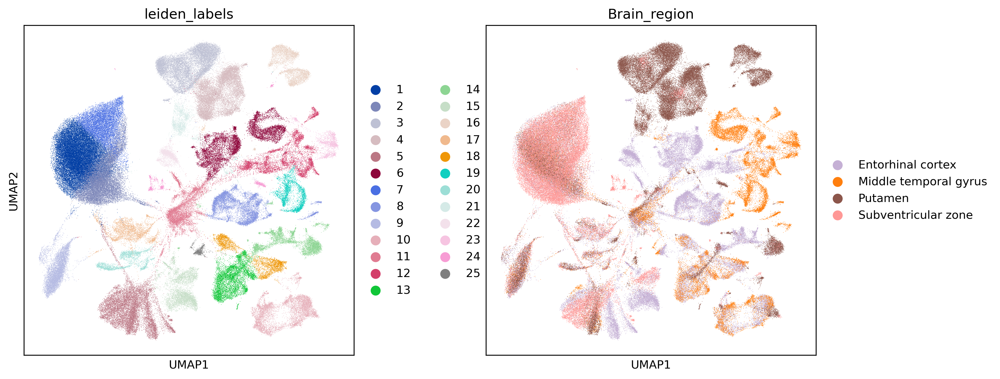

In [49]:
pg.scatter(data, attrs=['leiden_labels', 'Brain_region'], basis='umap')

## Differential Expression Analysis

With the clusters ready, we can now perform Differential Expression (DE) Analysis. DE analysis is to discover cluster-specific marker genes. For each cluster, it compares cells within the cluster with all the others, then finds genes significantly highly expressed (up-regulated) and lowly expressed (down-regulated) for the cluster.

Now use `de_analysis` method to run DE analysis. We use Louvain result here. 

In [50]:
pg.de_analysis(data, cluster='leiden_labels')

2021-10-08 20:23:27,360 - pegasus.tools.diff_expr - INFO - CSR matrix is converted to CSC matrix. Time spent = 6.6738s.


2021-10-08 20:23:36.877895: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.11.0
2021-10-08 20:23:36.891725: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.11.0
2021-10-08 20:23:36.895600: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.11.0
2021-10-08 20:23:36.896872: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.11.0
2021-10-08 20:23:36.905174: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.11.0
2021-10-08 20:23:36.919840: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.11.0
2021-10-08 20:23:36.928669: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic libr

2021-10-08 20:23:42,825 - pegasus.tools.diff_expr - INFO - MWU test and AUROC calculation are finished. Time spent = 15.4660s.
2021-10-08 20:23:43,792 - pegasus.tools.diff_expr - INFO - Sufficient statistics are collected. Time spent = 0.9667s.
2021-10-08 20:23:43,890 - pegasus.tools.diff_expr - INFO - Differential expression analysis is finished.
2021-10-08 20:23:43,891 - pegasus.tools.diff_expr - INFO - Function 'de_analysis' finished in 23.21s.


By default, DE analysis runs Mann-Whitney U (MWU) test.

Alternatively, you can also run the follow tests by setting their corresponding parameters to be `True`:
* `fisher`: Fisher’s exact test.
* `t`: Welch’s T test.

DE analysis result is stored with key `"de_res"` (by default) in `varm` field of data. See [documentation](https://pegasus.readthedocs.io/en/stable/api/pegasus.de_analysis.html) for more details. 

To load the result in a human-readable format, use `markers` method:

In [51]:
marker_dict = pg.markers(data)

By default, `markers`:
* Sort genes by Area under ROC curve (AUROC) in descending order;
* Use $\alpha = 0.05$ significance level on q-values for inference.

See [documentation](https://pegasus.readthedocs.io/en/stable/api/pegasus.markers.html) for customizing these parameters.

Let's see the up-regulated genes for Cluster 1, and rank them in descending order with respect to log fold change:

In [52]:
marker_dict['1']['up'].sort_values(by='log2FC', ascending=False)

,log2Mean,log2Mean_other,log2FC,percentage,percentage_other,percentage_fold_change,auroc,mwu_U,mwu_pval,mwu_qval
feature,,,,,,,,,,
ST18,8.448267,2.189699,6.258568,99.563538,35.742004,2.785617,0.916860,3.540511e+09,0.000000e+00,0.000000e+00
RNF220,7.949855,2.177281,5.772574,98.959770,39.422291,2.510249,0.914129,3.529965e+09,0.000000e+00,0.000000e+00
PLP1,8.643494,2.953085,5.690409,99.418053,52.974346,1.876721,0.911464,3.519674e+09,0.000000e+00,0.000000e+00
MBP,8.151628,2.646580,5.505049,99.541718,49.012821,2.030932,0.914720,3.532246e+09,0.000000e+00,0.000000e+00
MOBP,6.981802,1.620992,5.360810,94.707939,29.031477,3.262250,0.889552,3.435057e+09,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...,...,...,...,...
PRRC2C,2.831756,3.113438,-0.281682,56.495964,70.480095,0.801588,0.503819,1.945526e+09,4.145959e-02,4.877899e-02
SRSF11,3.391129,3.691812,-0.300683,65.552483,77.851349,0.842021,0.509547,1.967645e+09,4.408362e-07,6.265008e-07
ATRX,3.718569,4.040252,-0.321684,69.382408,81.253960,0.853896,0.511420,1.974881e+09,1.684716e-09,2.514234e-09


We can also use Volcano plot to see the DE result. Below is such a plot w.r.t. Cluster 1 with MWU test results (by default):

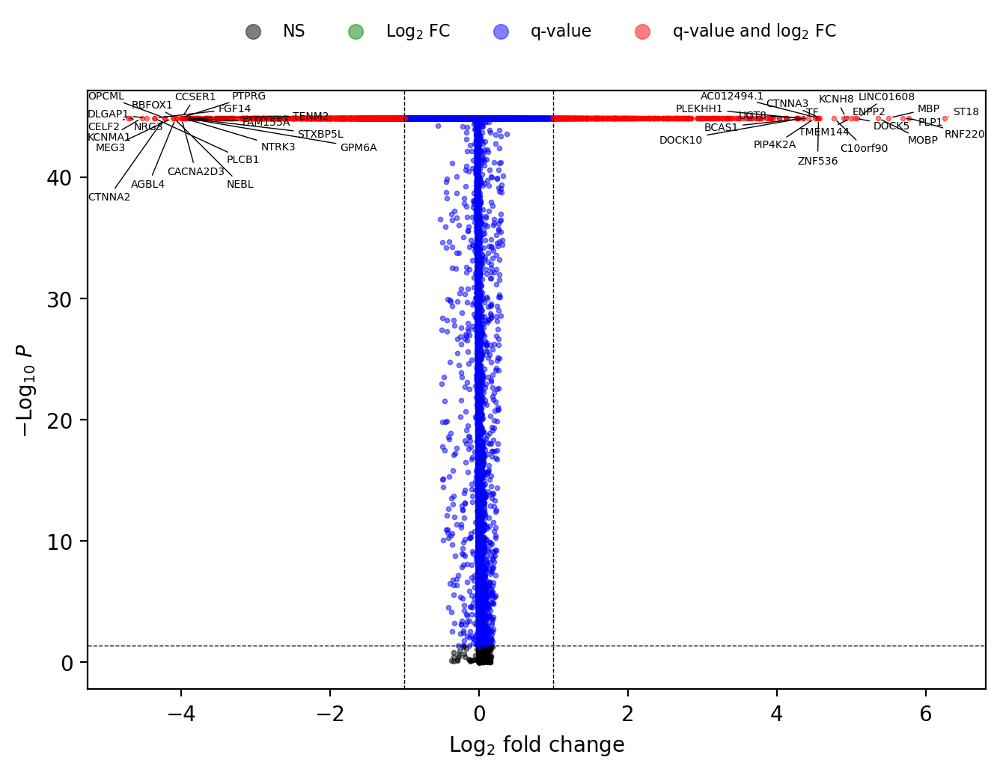

In [53]:
pg.volcano(data, cluster_id = '1', dpi=200)

The plot above uses the default thresholds: log fold change at $1$ (i.e. fold change at $2$), and q-value at $0.05$. Each point stands for a gene. Red ones are significant marker genes: those at right-hand side are up-regulated genes for Cluster 1, while those at left-hand side are down-regulated genes.

To store a specific DE analysis result to file, you can `write_results_to_excel` methods in `pegasus`:

In [54]:
# pg.write_results_to_excel(marker_dict, f'{data_name}_subset.de.xlsx')

## Cell Type Annotation

After done with DE analysis, we can use the test result to annotate the clusters.

In [55]:
markers_json

'/labshare/raph/datasets/adrd_neuro/aging/expression/human_brain_cell_markers_LNG.json'

In [56]:
celltype_dict = pg.infer_cell_types(data, markers=markers_json, threshold=0.05)
cluster_names = pg.infer_cluster_names(celltype_dict)

`infer_cell_types` has 2 critical parameters to set:
* `markers`: Either `'human_immune'`, `'mouse_immune'`, `'human_brain'`, `'mouse_brain'`, `'human_lung'`, or a user-specified marker dictionary.
* `de_test`: Decide which DE analysis test to be used for cell type inference. It can be either `'t'`, `'fisher'`, or `'mwu'`. Its default is `'mwu'`.

`infer_cluster_names` by default uses `threshold = 0.5` to filter out candidate cell types of scores lower than 0.5.

See [documentation](https://pegasus.readthedocs.io/en/stable/api/pegasus.infer_cell_types.html) for details.

Below is the cell type annotation report for the Clusters:

In [57]:
data.obs['leiden_labels'].value_counts()

1     27494
2     13881
3     12272
4     12051
5     11795
6      9292
7      8409
8      7025
9      6660
10     6635
11     6596
12     6045
13     6040
14     5240
15     5058
16     4200
17     3254
18     3200
19     2867
20     2220
21     2079
22     2038
23     1898
24     1066
25      630
Name: leiden_labels, dtype: int64

In [58]:
for leid_label in data.obs['leiden_labels'].unique():
    print(leid_label)
    print(celltype_dict[leid_label])

6
[name: Neuron; score: 0.80; average marker percentage: 46.30%; strong support: (RBFOX3+,94.45%),(CAMK2B+,86.40%),(NEFL+,46.90%); weak support: (ZNF3+,11.27%),(SLC6A4+,2.35%),(SYNJ2BP+,36.44%), name: Mural; score: 0.36; average marker percentage: 19.55%; weak support: (PDGFRB+,6.07%),(AQP4-,12.00%),(GFAP-,4.30%),(VTN+,2.73%),(ACTA2+,9.97%),(CALD1+,63.82%),(FLNA+,15.14%), name: Astrocyte; score: 0.29; average marker percentage: 56.91%; strong support: (CPE+,93.52%); weak support: (SLC1A2+,71.76%),(CLU+,53.31%),(ALDOC+,9.04%), name: OPC_ODC; score: 0.29; average marker percentage: 98.15%; strong support: (CNTN1+,99.12%),(TNR+,97.18%), name: Microglia; score: 0.17; average marker percentage: 15.89%; weak support: (P2RY12+,24.49%),(CCL4+,0.25%),(CTSS+,20.70%),(CD83+,18.13%), name: Endothelial; score: 0.13; average marker percentage: 20.90%; weak support: (BSG+,34.41%),(SLC2A1+,7.39%)]
1
[name: Oligodendrocyte; score: 0.98; average marker percentage: 64.73%; strong support: (PLP1+,99.42%),

The report has a list of predicted cell types along with their scores and support genes for users to decide.

Next, substitute the inferred cluster names in data using `annotate` function:

In [59]:
pg.annotate(data, name='anno', based_on='leiden_labels', anno_dict=cluster_names)
data.obs['anno'].value_counts()

Oligodendrocyte                 27494
Oligodendrocyte-2               13881
GABAergic neuron                12272
GABAergic neuron-2              12051
Astrocyte                       11795
Glutamatergic neuron LAMP5       9292
Oligodendrocyte-3                8409
Glutamatergic neuron FEZF2       7025
OPC_ODC                          6660
GABAergic neuron PVALB           6635
11                               6596
Glutamatergic neuron RORB        6045
13                               6040
GABAergic neuron SST             5240
Astrocyte-2                      5058
GABAergic neuron-3               4200
Microglia                        3254
OPC_ODC-2                        3200
Glutamatergic neuron LAMP5-2     2867
Endothelial                      2220
GABAergic neuron-4               2079
Glutamatergic neuron LAMP5-3     2038
Glutamatergic neuron RORB-2      1898
GABAergic neuron-5               1066
25                                630
Name: anno, dtype: int64

So the cluster-specific cell type information is stored in `data.obs['anno']`.

The `anno_dict` can be either a list or a dictionary. If provided a list (which is the case here), Pegasus will match cell types with cluster labels in the same order. Alternatively, you can create an annotation dictionary with keys being cluster labels and cell types being values.

In practice, users may want to manually create this annotation structure by reading the report in `celltype_dict`. In this tutorial, we'll just use the output of `infer_cluster_names` function for demonstration.

Now plot the data with cell types:

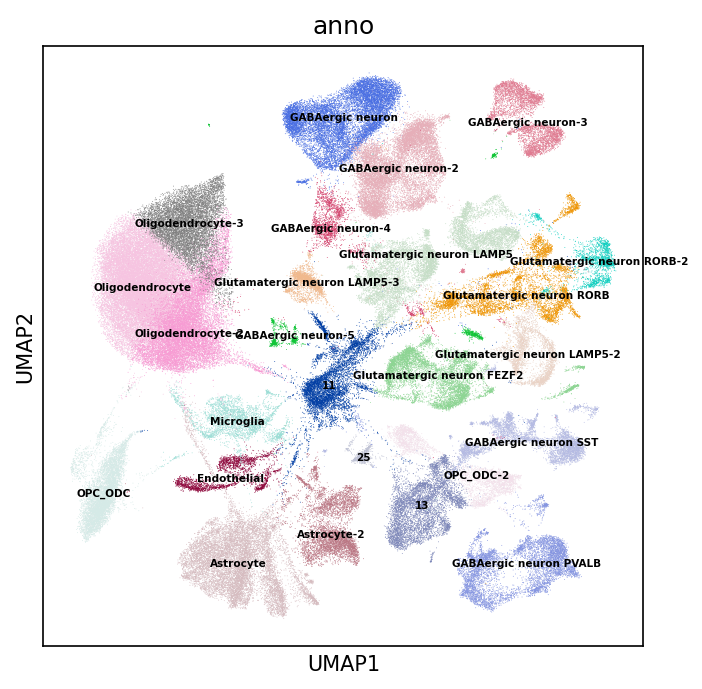

In [60]:
pg.scatter(data, attrs='anno', basis='umap', legend_loc='on data', dpi=150)

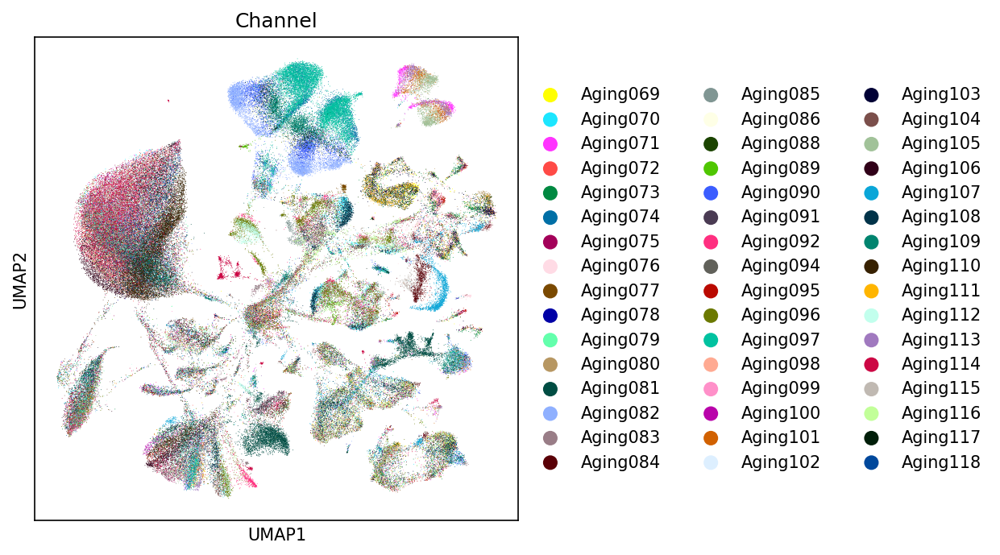

In [61]:
pg.scatter(data, attrs=['Channel'], basis='umap', dpi=150)

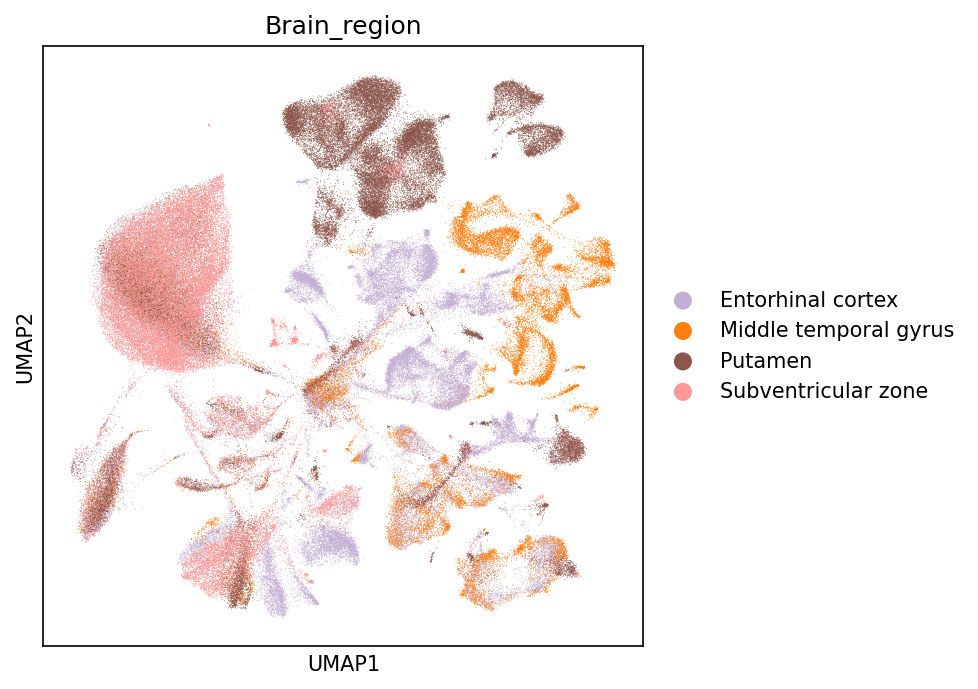

In [62]:
pg.scatter(data, attrs=['Brain_region'], basis='umap', dpi=150)

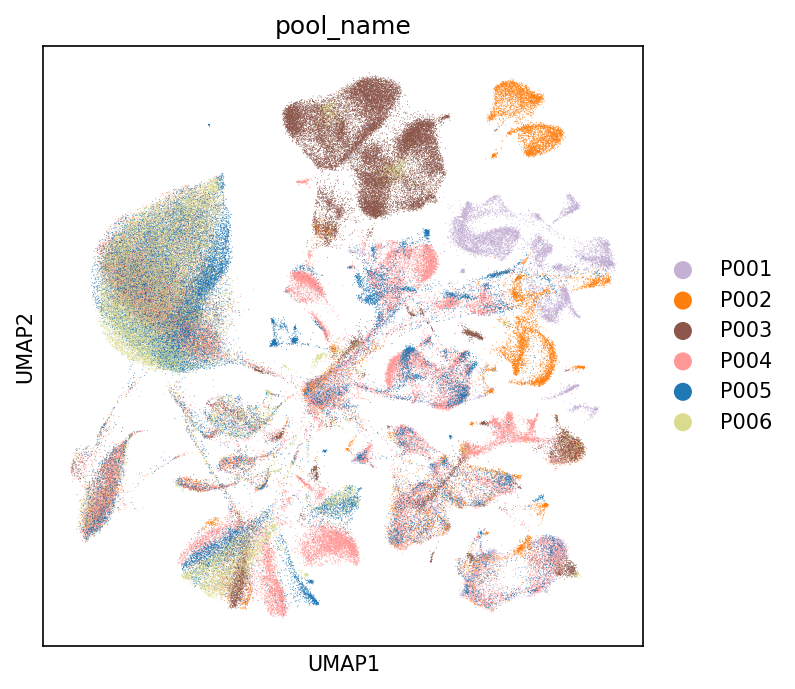

In [63]:
pg.scatter(data, attrs=['pool_name'], basis='umap', dpi=150)

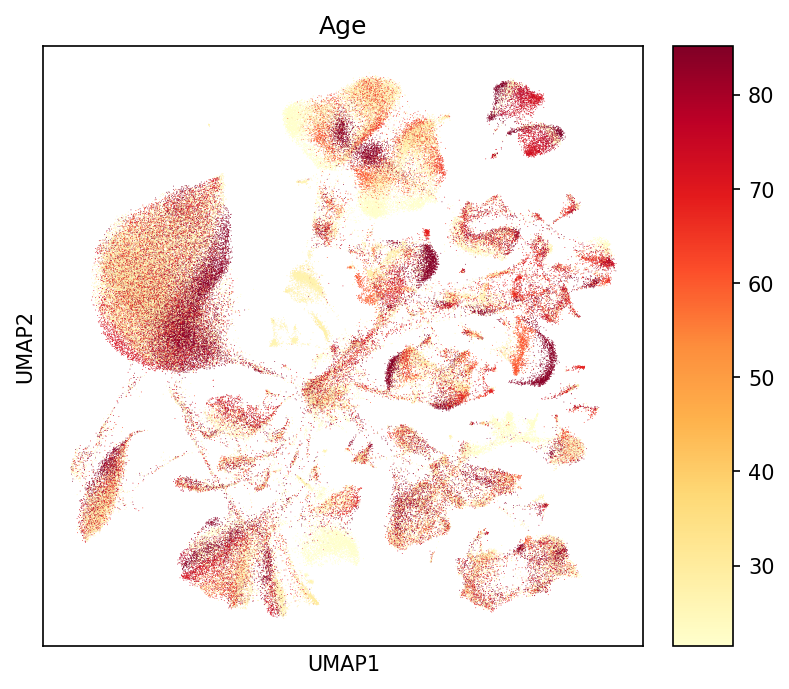

In [64]:
pg.scatter(data, attrs=['Age'], basis='umap', dpi=150)

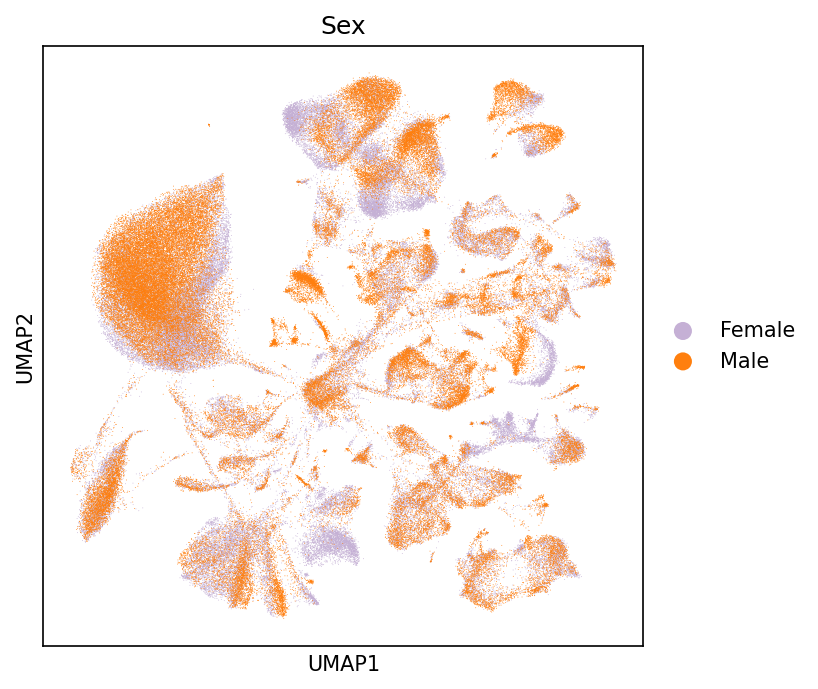

In [65]:
pg.scatter(data, attrs=['Sex'], basis='umap', dpi=150)

## Raw Count vs Log-norm Count

Now let's check the count matrix:

In [66]:
data

MultimodalData object with 1 UnimodalData: 'unknown-rna'
    It currently binds to UnimodalData object unknown-rna

UnimodalData object with n_obs x n_vars = 167945 x 35441
    Genome: unknown; Modality: rna
    It contains 2 matrices: 'X', 'raw.X'
    It currently binds to matrix 'X' as X

    obs: 'pool_name', 'Sample_id', 'Tissue_source', 'Brain_region', 'Clinical_diagnosis', 'Age', 'Sex', 'donor_id', 'lane_num', 'Channel', 'n_genes', 'n_counts', 'percent_mito', 'scale', 'Group', 'leiden_labels', 'anno'
    var: 'n_cells', 'percent_cells', 'robust', 'highly_variable_features', 'mean', 'var', 'hvf_loess', 'hvf_rank'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    varm: 'means', 'partial_sum', 'gmeans', 'gstds', 'de_res'
    uns: 'genome', 'modality', 'df_qcplot', 'norm_count', 'Channels', 'Groups', 'ncells', 'gncells', 'c2gid', 'stdzn_mean', 'stdzn_std', 'stdzn_max_value', '_tmp_fmat_highly_variable_features', 'PCs', 'pca', 'pca_features', 'pca_harmony_knn_indices', 'pca_harmony_knn

You can see that besides `X`, there is another matrix `raw.X` generated for this analysis. As the key name indicates, `raw.X` stores the raw count matrix, which is the one after loading from the original Zarr file; while `X` stores the log-normalized counts.

`data` currently binds to matrix `X`. To use the raw count instead, type:

In [67]:
data.select_matrix('raw.X')
data

MultimodalData object with 1 UnimodalData: 'unknown-rna'
    It currently binds to UnimodalData object unknown-rna

UnimodalData object with n_obs x n_vars = 167945 x 35441
    Genome: unknown; Modality: rna
    It contains 2 matrices: 'X', 'raw.X'
    It currently binds to matrix 'raw.X' as X

    obs: 'pool_name', 'Sample_id', 'Tissue_source', 'Brain_region', 'Clinical_diagnosis', 'Age', 'Sex', 'donor_id', 'lane_num', 'Channel', 'n_genes', 'n_counts', 'percent_mito', 'scale', 'Group', 'leiden_labels', 'anno'
    var: 'n_cells', 'percent_cells', 'robust', 'highly_variable_features', 'mean', 'var', 'hvf_loess', 'hvf_rank'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    varm: 'means', 'partial_sum', 'gmeans', 'gstds', 'de_res'
    uns: 'genome', 'modality', 'df_qcplot', 'norm_count', 'Channels', 'Groups', 'ncells', 'gncells', 'c2gid', 'stdzn_mean', 'stdzn_std', 'stdzn_max_value', '_tmp_fmat_highly_variable_features', 'PCs', 'pca', 'pca_features', 'pca_harmony_knn_indices', 'pca_harmony

Now `data` binds to raw counts.

We still need log-normalized counts for the following sections, so reset the default count matrix:

In [68]:
data.select_matrix('X')

## Cell Development Trajectory and Diffusion Map

Alternative, pegasus provides cell development trajectory plots using Force-directed Layout (FLE) algorithm:

* `pg.fle`: FLE plot, using Force-Atlas 2 algorithm in [forceatlas2-python](https://github.com/klarman-cell-observatory/forceatlas2-python) package. [See details](https://pegasus.readthedocs.io/en/stable/api/pegasus.fle.html)
* `pg.net_fle`: Approximated FLE plot with DNN model based speed up. [See details](https://pegasus.readthedocs.io/en/stable/api/pegasus.net_fle.html)

Moreover, calculation of FLE plots is on Diffusion Map of the data, rather than directly on data points, in order to achieve a better efficiency. Thus, we need to first compute the diffusion map structure:

In [69]:
pg.diffmap(data, rep=pca_key)

2021-10-08 20:24:07,211 - pegasus.tools.diffusion_map - INFO - Calculating connected components is done.
2021-10-08 20:24:07,879 - pegasus.tools.diffusion_map - INFO - Calculating normalized affinity matrix is done.
2021-10-08 20:25:25,325 - pegasus.tools.diffusion_map - INFO - Detected knee point at t = 264.
2021-10-08 20:25:25,391 - pegasus.tools.diffusion_map - INFO - Function 'diffmap' finished in 78.40s.


By default, diffmap method uses:

* Number of Diffusion Components = 100
* Compute diffusion map from PCA matrix.

In this tutorial, we should use the corrected PCA matrix, which is specified in `pca_key`. The resulting diffusion map is in `data.obsm` with key `"X_diffmap"`:

In [70]:
data.obsm['X_diffmap'].shape

(167945, 99)

Now we are ready to calculate the pseudo-temporal trajectories of cell development. We use `fle` here:

In [71]:
pg.fle(data)

2021-10-08 20:25:46,836 - pegasus.tools.nearest_neighbors - INFO - Function 'get_neighbors' finished in 21.43s.
2021-10-08 20:25:50,898 - pegasus.tools.nearest_neighbors - INFO - Function 'calculate_affinity_matrix' finished in 4.06s.
2021-10-08 20:25:53,775 - pegasus.tools.graph_operations - INFO - Function 'construct_graph' finished in 2.88s.


Oct 08, 2021 8:25:58 PM org.netbeans.modules.masterfs.watcher.Watcher getNotifierForPlatform
INFO: Native file watcher is disabled
Oct 08, 2021 8:26:29 PM org.gephi.io.processor.plugin.DefaultProcessor process
INFO: # Nodes loaded: 167,945
Oct 08, 2021 8:26:29 PM org.gephi.io.processor.plugin.DefaultProcessor process
INFO: # Edges loaded: 5,148,910


100 iterations, change_per_node = 577.2455285231914
200 iterations, change_per_node = 254.3363132597894
300 iterations, change_per_node = 233.60355649182995
400 iterations, change_per_node = 228.5385152703625
calc_mwu finished for genes in [1662, 2216).
calc_mwu finished for genes in [0, 554).
calc_mwu finished for genes in [2770, 3324).
calc_mwu finished for genes in [2216, 2770).
calc_mwu finished for genes in [11080, 11634).
calc_mwu finished for genes in [29911, 30464).
calc_mwu finished for genes in [7756, 8310).
calc_mwu finished for genes in [15512, 16066).
calc_mwu finished for genes in [3324, 3878).
calc_mwu finished for genes in [33229, 33782).
calc_mwu finished for genes in [12742, 13296).
calc_mwu finished for genes in [30464, 31017).
calc_mwu finished for genes in [31017, 31570).
calc_mwu finished for genes in [25484, 26038).
calc_mwu finished for genes in [27146, 27699).
calc_mwu finished for genes in [26038, 26592).
calc_mwu finished for genes in [31570, 32123).
calc_mwu

And show FLE plot regarding cell type annotations:

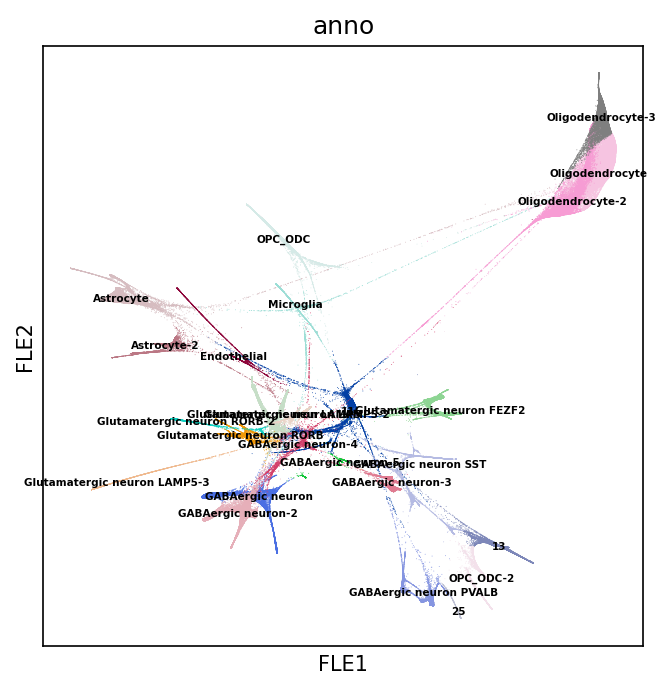

In [72]:
pg.scatter(data, attrs='anno', basis='fle', legend_loc='on data', dpi=150)

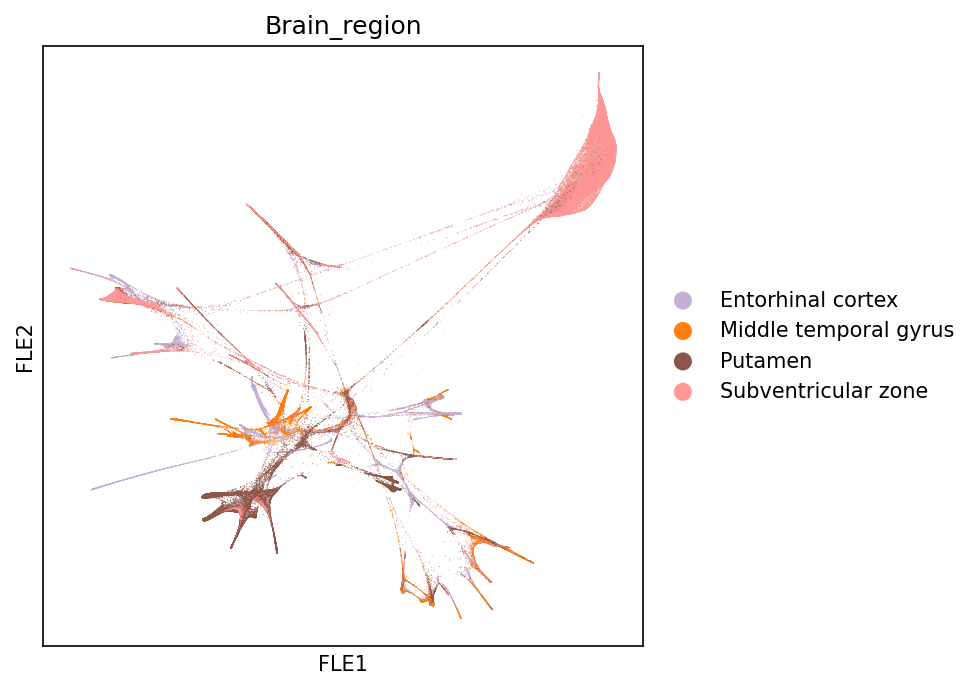

In [73]:
pg.scatter(data, attrs='Brain_region', basis='fle', dpi=150)

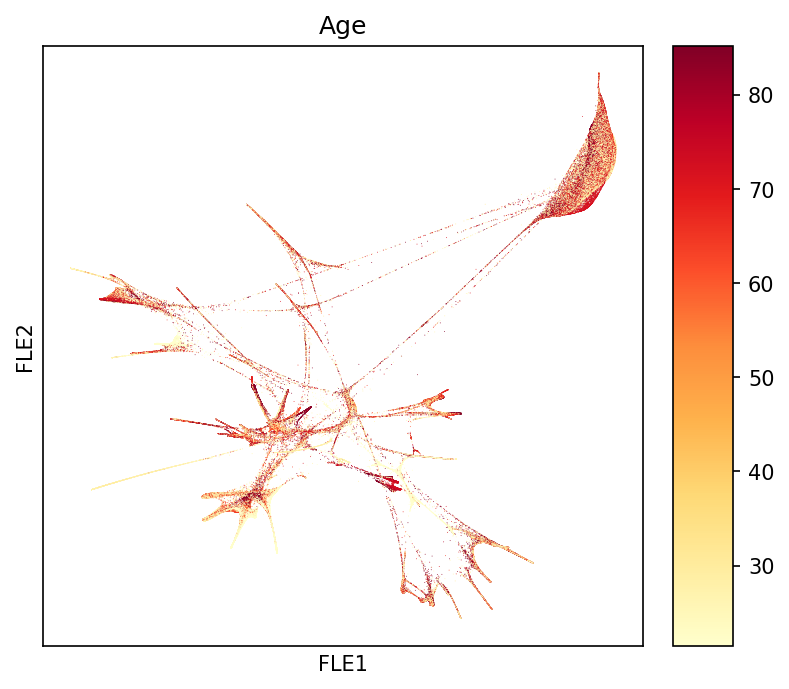

In [74]:
pg.scatter(data, attrs='Age', basis='fle', legend_loc='on data', dpi=150)

## Save Result to File

Use `write_output` function to save analysis result `data` to file:

In [75]:
pg.write_output(data, output_file, file_type='h5ad')

2021-10-08 20:52:48,794 - pegasusio.readwrite - INFO - h5ad file '/labshare/raph/datasets/adrd_neuro/aging/demux/aging.pegasus.h5ad' is written.
2021-10-08 20:52:48,797 - pegasusio.readwrite - INFO - Function 'write_output' finished in 263.19s.


It's stored in `h5ad` format, because this is the default file format in Pegasus.

Alternatively, you can also save it in `zarr`, `mtx`, or `loom` format.  See [its documentation](https://pegasus.readthedocs.io/en/stable/api/pegasus.write_output.html) for instructions.

## Read More...

* Read [Plotting Tutorial](https://pegasus.readthedocs.io/en/stable/_static/tutorials/plotting_tutorial.html) for more plotting functions provided by Pegasus.

* Read [Pegasus API](https://pegasus.readthedocs.io/en/stable/api/index.html) documentation for details on Pegasus functions.

Feature Plot
Besides plotting cell attributes in data.obs, you can also specify gene names in attrs parameter of scatter function to generate Feature Plots, which is useful for inspecting specific genes in details.

Below are feature plots of genes, together with UMAP plot of cell type annotations:

In [76]:
marker_genes = ["SLC17A7", "RORB", "THEMIS", "FEZF2", "GAD1", "SST", "VIP", "PVALB", 
                "PDGFRA", "OLIG2", "PLP1", "MOBP", "SLC1A2", "SLC1A3", "GFAP", "AQP4", 
                "P2RY12", "ITGAM", "CSF1R", "CX3CR1","CLDN5", "COLEC12"]
marker_genes = list(set(marker_genes) & set(data.var_names))

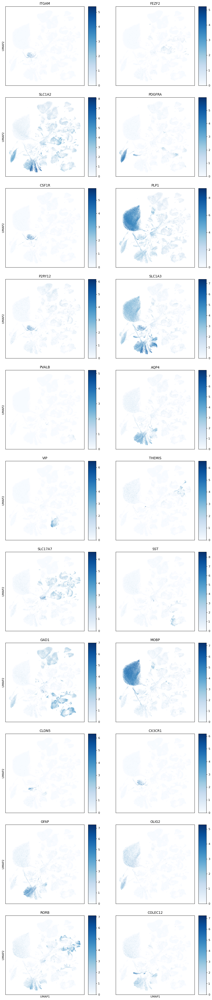

In [77]:
pg.scatter(data, attrs=marker_genes, basis='umap', ncols=2, dpi=80, cmaps='Blues')

Violin Plot
The violin plot gives us an idea of the distribution of gene expression values across clusters. The violin plot below shows the expression of the marker gene set we use in this tutorial against Louvain clusters:

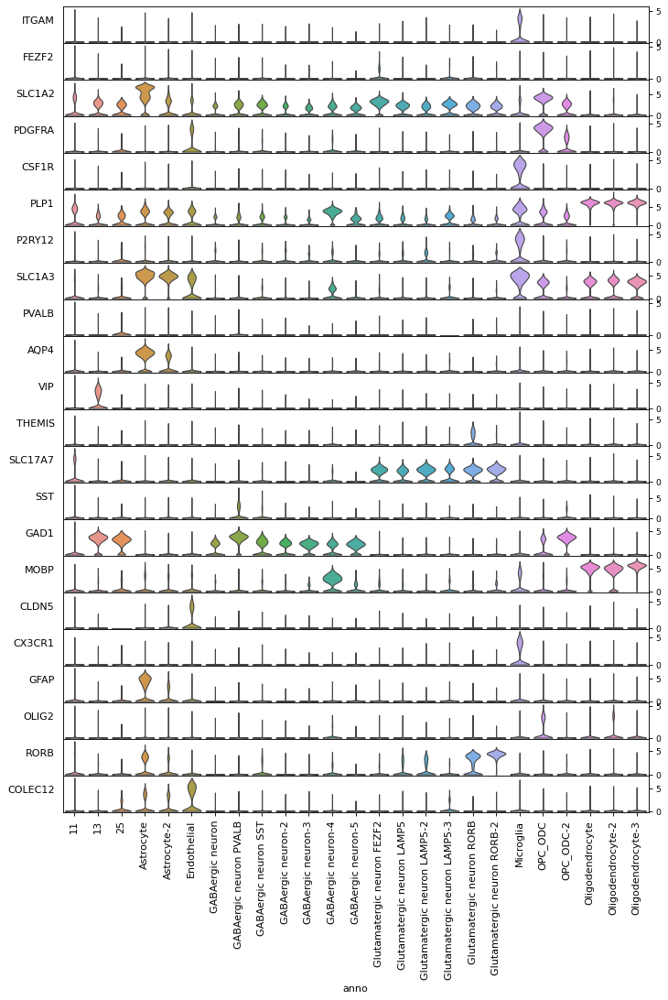

In [78]:
pg.violin(data, attrs=marker_genes, groupby='anno', dpi=80)

Heat Map
Besides Violin Plot, Pegasus also provides Heat Map.

It is also useful to add a dendrogram to the graph to bring together similar clusters or genes, based on the expression of selected genes.

By default, heatmap shows a Heat Map based on average expression of selected genes within each cluster, and cluster similar genes altogether. You can set row_cluster=True to merge similar clusters:

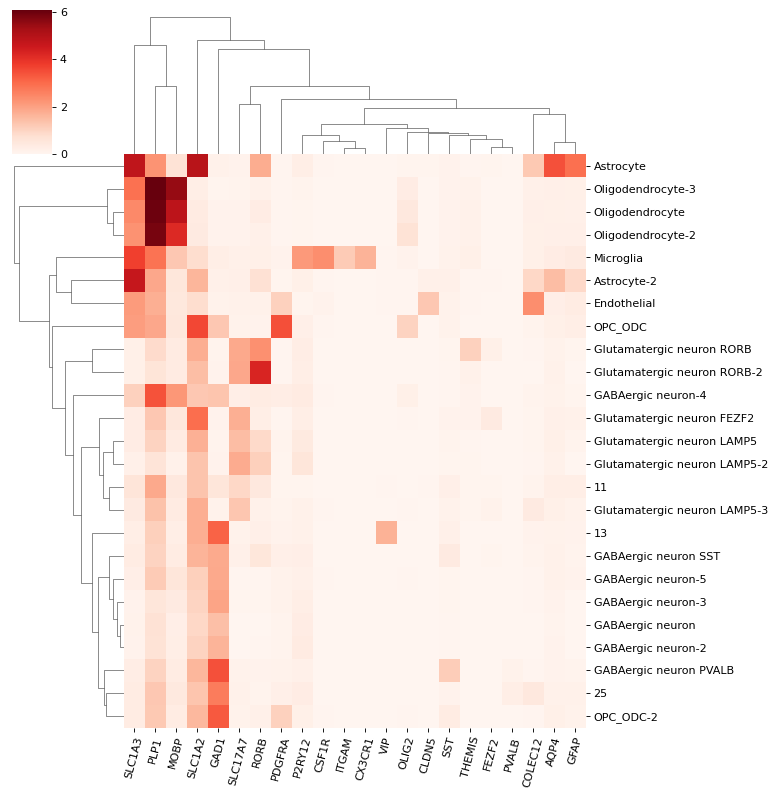

In [79]:
pg.heatmap(data, attrs=marker_genes, attrs_cluster=True, groupby='anno', dpi=80)

Dot Plot
Dot plot is an alternative to Heat map. Besides the mean expression of a gene within a cluster (dot color), it also conveys the fraction of cells within the cluster expressing that gene (dot size):



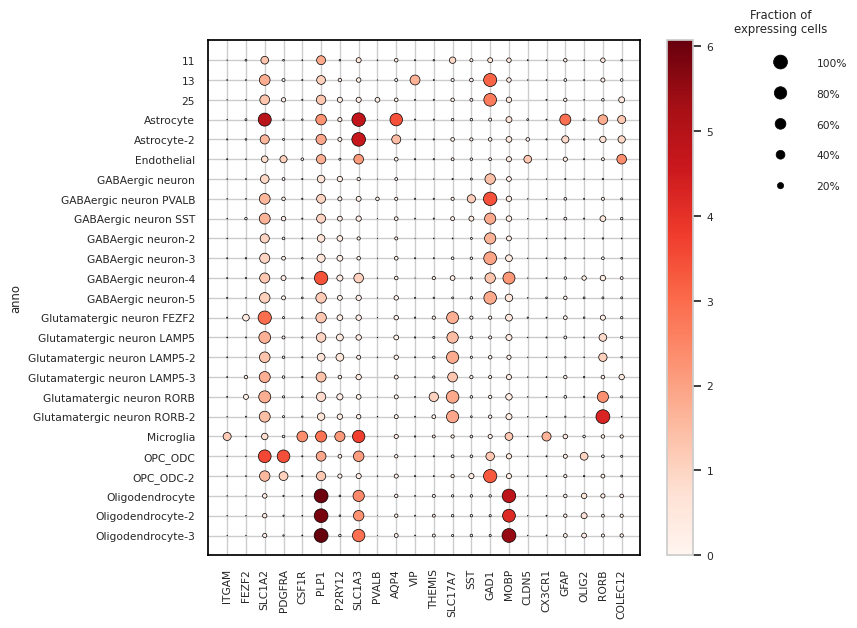

In [80]:
pg.dotplot(data, genes=marker_genes, groupby='anno', dpi=100)

Dendrogram
Pegasus provides dendrograms based on hierarchical clustering. There are 2 ways for clustering: one is regarding the expression of a selected set of genes:

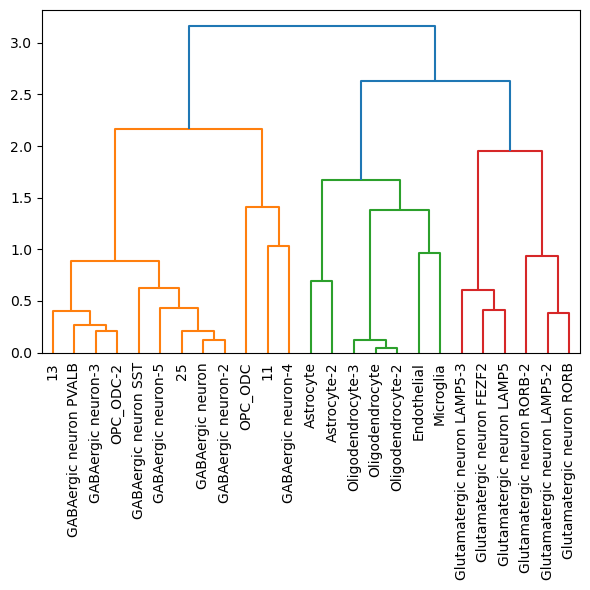

In [81]:
pg.dendrogram(data, genes=marker_genes, groupby='anno', dpi=100)

Volcano Plot
Differential Expression (DE) Analysis is to discover cluster-specific marker genes. For each cluster, it compares cells within the cluster with all the others, then finds genes significantly highly expressed (up-regulated) and lowly expressed (down-regulated) for the cluster.

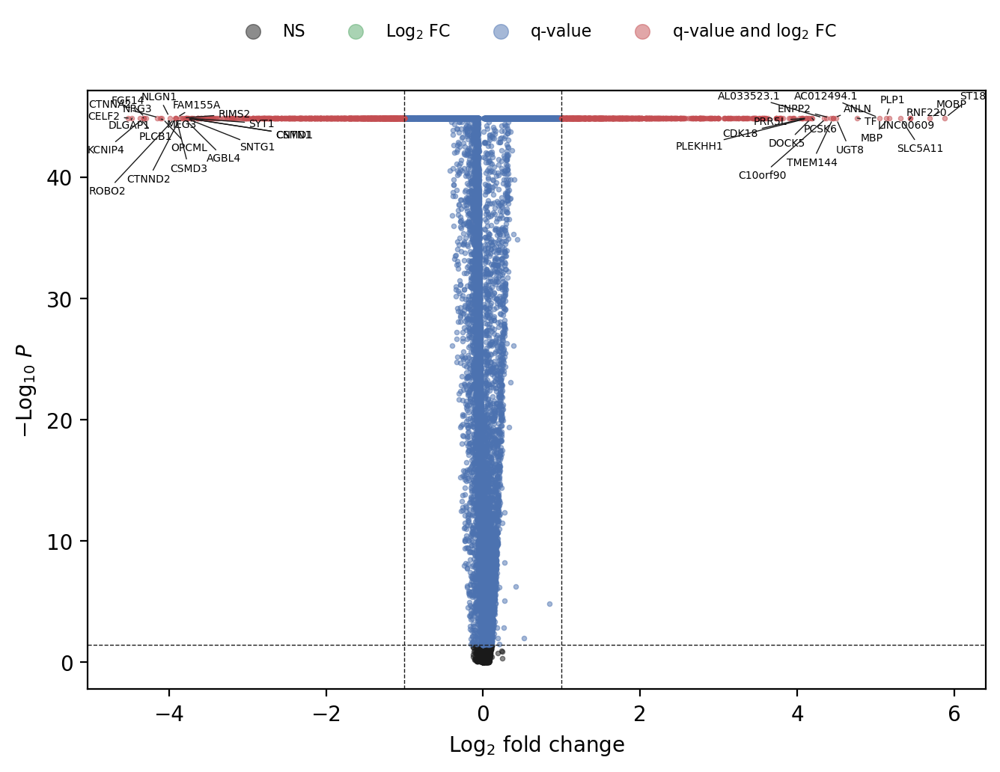

In [82]:
pg.volcano(data, cluster_id = '7', dpi=200)

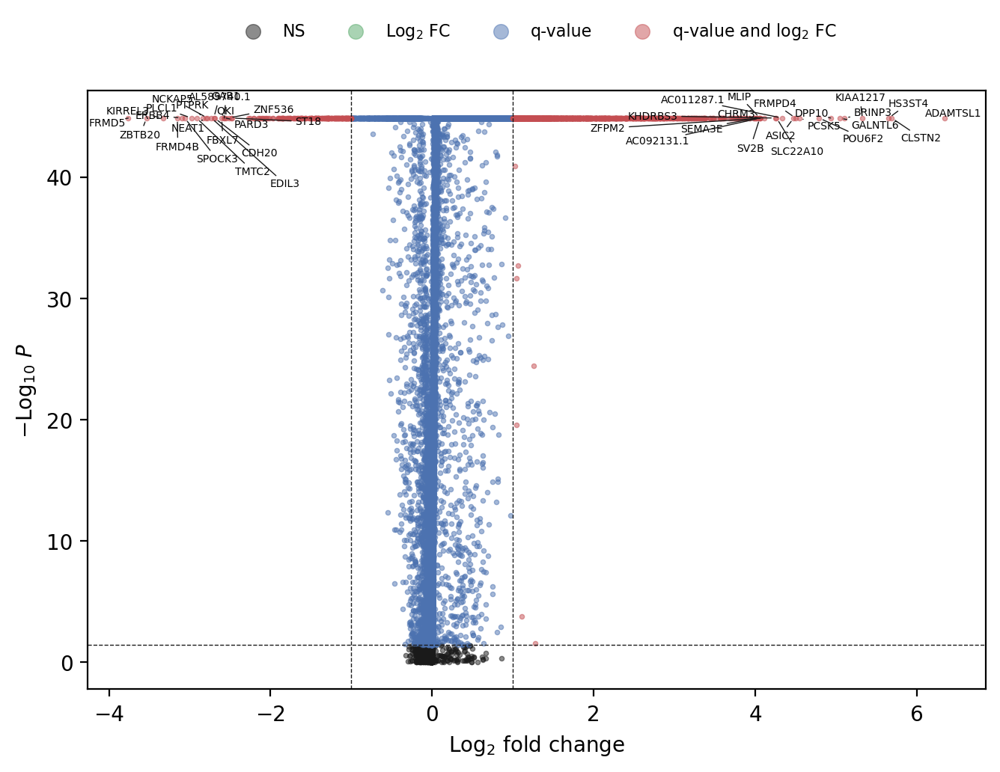

In [83]:
pg.volcano(data, cluster_id = '8', dpi=200)

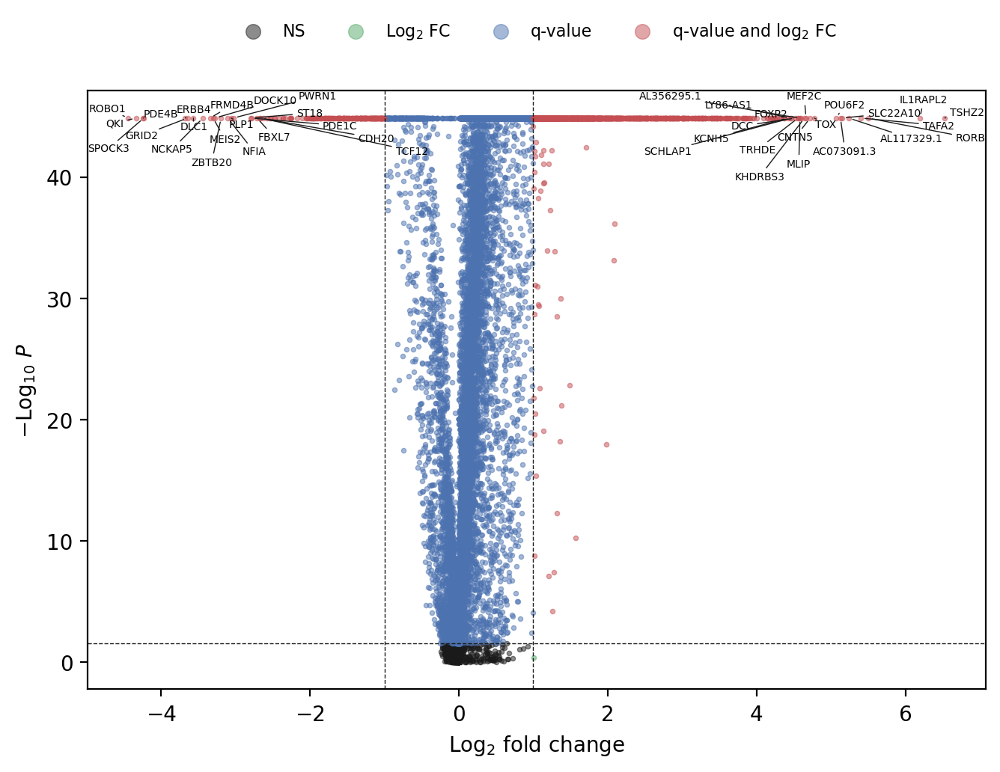

In [84]:
pg.volcano(data, cluster_id = '23', dpi=200)